# Improving Employee Retention By Predicting Employee Attrition

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings('ignore')

# Importing Data


In [2]:
df = pd.read_csv('hr_data.csv')
print(f'Number of rows: {df.shape[0]}')
print(f'Number of columns: {df.shape[1]}')
df.head()

Number of rows: 287
Number of columns: 25


,Username,EnterpriseID,StatusPernikahan,JenisKelamin,StatusKepegawaian,Pekerjaan,JenjangKarir,PerformancePegawai,AsalDaerah,HiringPlatform,...,NomorHP,Email,TingkatPendidikan,PernahBekerja,IkutProgramLOP,AlasanResign,TanggalLahir,TanggalHiring,TanggalPenilaianKaryawan,TanggalResign
0,spiritedPorpoise3,111065,Belum_menikah,Pria,Outsource,Software Engineer (Back End),Freshgraduate_program,Sangat_bagus,Jakarta Timur,Employee_Referral,...,+6282232522xxx,spiritedPorpoise3135@yahoo.com,Magister,1,1.0,masih_bekerja,1972-07-01,2011-01-10,2016-2-15,-
1,jealousGelding2,106080,Belum_menikah,Pria,FullTime,Data Analyst,Freshgraduate_program,Sangat_kurang,Jakarta Utara,Website,...,+6281270745xxx,jealousGelding2239@yahoo.com,Sarjana,1,1.0,toxic_culture,1984-04-26,2014-01-06,2020-1-17,2018-6-16
2,pluckyMuesli3,106452,Menikah,Pria,FullTime,Software Engineer (Front End),Freshgraduate_program,Bagus,Jakarta Timur,Indeed,...,+6281346215xxx,pluckyMuesli3961@icloud.com,Magister,1,1.0,jam_kerja,1974-01-07,2011-01-10,2016-01-10,2014-9-24
3,stressedTruffle1,106325,Belum_menikah,Pria,Outsource,Software Engineer (Front End),Freshgraduate_program,Bagus,Jakarta Pusat,LinkedIn,...,+6283233846xxx,stressedTruffle1406@hotmail.com,Sarjana,1,0.0,masih_bekerja,1979-11-24,2014-2-17,2020-02-04,-
4,shyTermite7,111171,Belum_menikah,Wanita,FullTime,Product Manager,Freshgraduate_program,Bagus,Jakarta Timur,LinkedIn,...,+6287883263xxx,shyTermite7149@gmail.com,Sarjana,1,0.0,ganti_karir,1974-11-07,2013-11-11,2020-1-22,2018-09-06


# Data Cleaning

In [3]:
# handling Missing value
100 * (df.isnull().sum() / df.shape[0]).sort_values(ascending=False)

IkutProgramLOP                        89.895470
AlasanResign                          22.996516
JumlahKetidakhadiran                   2.090592
SkorKepuasanPegawai                    1.742160
JumlahKeikutsertaanProjek              1.045296
JumlahKeterlambatanSebulanTerakhir     0.348432
StatusPernikahan                       0.000000
EnterpriseID                           0.000000
Username                               0.000000
AsalDaerah                             0.000000
PerformancePegawai                     0.000000
JenjangKarir                           0.000000
Pekerjaan                              0.000000
StatusKepegawaian                      0.000000
JenisKelamin                           0.000000
HiringPlatform                         0.000000
SkorSurveyEngagement                   0.000000
Email                                  0.000000
NomorHP                                0.000000
PernahBekerja                          0.000000
TingkatPendidikan                      0

**Findings:**<br>
- IkutProgramLOP has 89.89% missing value, indicating many employee do not take LOP Program
- AlasanResign has 22.99% missing value, suggesting the rest are not resigned
- The rest has some missing value under 5%

**Action:**<br>
- Feature "IkutPgroamLOP" will be dropped due to not useful for machine learning
- Missing value on "AlasanResign" will be filled with "masih_bekerja"
- The rest features with missing values will be filled number

In [4]:
missing_values_feat = ['JumlahKetidakhadiran', 'SkorKepuasanPegawai', 'JumlahKeikutsertaanProjek', 'JumlahKeterlambatanSebulanTerakhir', 'AlasanResign']
df[missing_values_feat].sample(5)

,JumlahKetidakhadiran,SkorKepuasanPegawai,JumlahKeikutsertaanProjek,JumlahKeterlambatanSebulanTerakhir,AlasanResign
223,1.0,3.0,0.0,0.0,NaN
253,13.0,5.0,0.0,0.0,jam_kerja
150,20.0,2.0,1.0,6.0,masih_bekerja
194,20.0,4.0,0.0,0.0,tidak_bisa_remote
15,NaN,3.0,0.0,0.0,toxic_culture


In [5]:
df[missing_values_feat].describe()

,JumlahKetidakhadiran,SkorKepuasanPegawai,JumlahKeikutsertaanProjek,JumlahKeterlambatanSebulanTerakhir
count,281.000000,282.000000,284.000000,286.000000
mean,10.448399,3.904255,1.179577,0.412587
std,6.902252,0.913355,2.294441,1.275016
min,1.000000,1.000000,0.000000,0.000000
25%,5.000000,3.000000,0.000000,0.000000
50%,10.000000,4.000000,0.000000,0.000000
75%,15.000000,5.000000,0.000000,0.000000
max,55.000000,5.000000,8.000000,6.000000


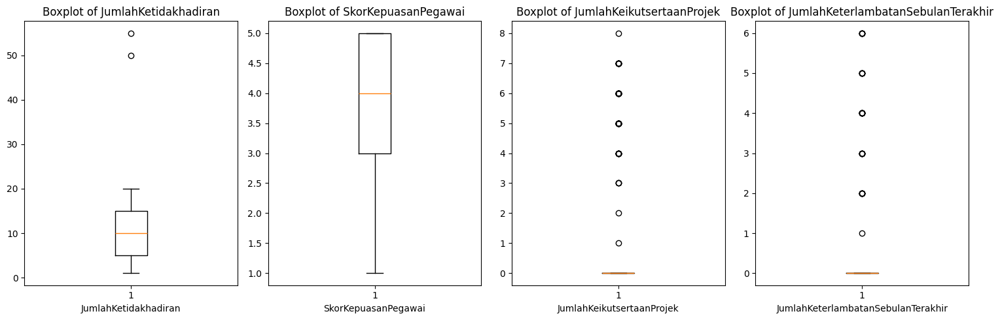

In [6]:
missing_values_feat_num = ['JumlahKetidakhadiran', 'SkorKepuasanPegawai', 
                       'JumlahKeikutsertaanProjek', 'JumlahKeterlambatanSebulanTerakhir']

plt.figure(figsize=(15, 5))

for i in range(len(missing_values_feat_num)):
    plt.subplot(1, len(missing_values_feat_num), i + 1)  # Create subplots in one row
    
    # Check if the column exists in the DataFrame before plotting
    if missing_values_feat_num[i] in df.columns:
        plt.boxplot(df[missing_values_feat_num[i]].dropna())
        plt.title(f'Boxplot of {missing_values_feat_num[i]}')
        plt.xlabel(missing_values_feat_num[i])
    else:
        print(f"Column '{missing_values_feat_num[i]}' does not exist in the DataFrame.")

plt.tight_layout()
plt.show()

**Findings:**<br>
- JumlahKetidakhadiran, JumlahKeikutsertaanProjek, dan JumlahKeterlambatanSebulanTerakhir have some outliers
- SkorKepuasanPegawai do not have outliers

**Action:**<br>
- Due to outliers, to fill missing value will use median because it is robust from outliers
- SkorkepuasanPegawai will be filled with mode because this feature is ordinal scale which is mode will be the best imputation

In [7]:
# Handling missing values def function
def handling_na(df):
    # Drop IkutProgramLOP
    df = df.drop(columns=['IkutProgramLOP'])

    # Fill missing values with mode
    mode_value = df['SkorKepuasanPegawai'].mode().iloc[0]  # Use mode in the first value
    df['SkorKepuasanPegawai'] = df['SkorKepuasanPegawai'].fillna(mode_value)

    # Fill missing values with median
    fill_median = ['JumlahKetidakhadiran', 'JumlahKeikutsertaanProjek', 'JumlahKeterlambatanSebulanTerakhir']
    for col in fill_median:
        df[col] = df[col].fillna(df[col].median())

    # Fill missing values with "masih bekerja"
    df['AlasanResign'] = df['AlasanResign'].fillna('masih_bekerja')

    return df

df_cleaned = handling_na(df)
print(f'Number of rows after cleaned: {df_cleaned.shape[0]}')
print(f'Number of columns after cleaned: {df_cleaned.shape[1]}')
print('\nMissing values after cleaned:')
df_cleaned.isnull().sum()

Number of rows after cleaned: 287
Number of columns after cleaned: 24

Missing values after cleaned:


Username                              0
EnterpriseID                          0
StatusPernikahan                      0
JenisKelamin                          0
StatusKepegawaian                     0
Pekerjaan                             0
JenjangKarir                          0
PerformancePegawai                    0
AsalDaerah                            0
HiringPlatform                        0
SkorSurveyEngagement                  0
SkorKepuasanPegawai                   0
JumlahKeikutsertaanProjek             0
JumlahKeterlambatanSebulanTerakhir    0
JumlahKetidakhadiran                  0
NomorHP                               0
Email                                 0
TingkatPendidikan                     0
PernahBekerja                         0
AlasanResign                          0
TanggalLahir                          0
TanggalHiring                         0
TanggalPenilaianKaryawan              0
TanggalResign                         0
dtype: int64

In [8]:
# Handling Values
def check_unique_value(df):
    for i in df.columns:
        print(f"{i} \n {np.sort(df[i].unique())} \n")

check_unique_value(df_cleaned)

Username 
 ['abjectRuffs3' 'aboardUnicorn8' 'adoringCardinal9' 'adoringMacaw3'
 'affectedLemur7' 'affectedLollies9' 'affectedPup0' 'alertDoughnut7'
 'alertSyrup3' 'aloofBasmati5' 'aloofChile5' 'amazedMoth0' 'amazedRhino8'
 'amusedIcecream0' 'annoyedSalt4' 'annoyedWhiting8' 'anxiousTeal2'
 'anxiousWasp6' 'ardentLapwing0' 'artisticTacos7' 'ashamedSyrup5'
 'awedBaboon6' 'betrayedHeron3' 'betrayedLizard5' 'blissfulCow2'
 'blissfulGnu4' 'blissfulHyena1' 'blissfulMussel3' 'boastfulDinosaur8'
 'boastfulLlama7' 'boastfulSyrup4' 'boastfulWasp1' 'boredEggs0'
 'boredHyena0' 'boredTortoise1' 'brainyBittern0' 'brainyFish3'
 'brainyGranola0' 'brainyLlama9' 'brainyMagpie7' 'brainyRice8'
 'brainySalt8' 'bubblyPup4' 'cautiousLeopard7' 'cautiousOwl6'
 'cautiousPolenta9' 'cautiousPonie3' 'cautiousTortoise1' 'cheerfulPear0'
 'chicPlover7' 'chicSalami4' 'cockyBuzzard5' 'cockyTeal5' 'cockyTruffle7'
 'contentAbalone0' 'cruelCaviar1' 'cruelGnu6' 'cruelWidgeon9'
 'crummyPolenta1' 'crummyPudding5' 'crushedHyena

Feature "PernahBekerja" have 2 values, "1" and "Yes", usually, "1" is representated as "yes" meaning:

In [9]:
df_cleaned['PernahBekerja'].value_counts()

PernahBekerja
1      286
yes      1
Name: count, dtype: int64

In [10]:
df_cleaned['PernahBekerja'] = df_cleaned['PernahBekerja'].replace({'1': 'yes'})
df_cleaned['PernahBekerja'].value_counts()

PernahBekerja
yes    287
Name: count, dtype: int64

All of employees have worked before, since the values shows one unique value, it will give no more information for machine learning. So, the "PernahBekerja" feature will be **dropped**.

In [11]:
# Drop PernahBekerja
print(f'Total Number of columns before drop: {df_cleaned.shape[1]}')
df_cleaned = df_cleaned.drop(columns=['PernahBekerja'], axis = 1)
print(f'Total Number of columns after drop: {df_cleaned.shape[1]}')

Total Number of columns before drop: 24
Total Number of columns after drop: 23


# Exploratory Data Analysis

In [12]:
df_eda = df_cleaned.copy()

## Statistics Descriptive

In [13]:
df_eda.describe()

,EnterpriseID,SkorSurveyEngagement,SkorKepuasanPegawai,JumlahKeikutsertaanProjek,JumlahKeterlambatanSebulanTerakhir,JumlahKetidakhadiran
count,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000
mean,105923.324042,3.101045,3.888502,1.167247,0.411150,10.439024
std,4044.977599,0.836388,0.913060,2.285537,1.273018,6.829769
min,100282.000000,1.000000,1.000000,0.000000,0.000000,1.000000
25%,101269.000000,3.000000,3.000000,0.000000,0.000000,5.000000
50%,106069.000000,3.000000,4.000000,0.000000,0.000000,10.000000
75%,110514.500000,4.000000,5.000000,0.000000,0.000000,15.000000
max,111703.000000,5.000000,5.000000,8.000000,6.000000,55.000000


In [14]:
cols_cat = ['StatusPernikahan', 'JenisKelamin', 'StatusKepegawaian', 'Pekerjaan', 'JenjangKarir', 'PerformancePegawai', 'AsalDaerah', 'HiringPlatform',
            'TingkatPendidikan', 'AlasanResign']
df_eda[cols_cat].describe()

,StatusPernikahan,JenisKelamin,StatusKepegawaian,Pekerjaan,JenjangKarir,PerformancePegawai,AsalDaerah,HiringPlatform,TingkatPendidikan,AlasanResign
count,287,287,287,287,287,287,287,287,287,287
unique,5,2,3,14,3,5,5,9,3,11
top,Belum_menikah,Wanita,FullTime,Software Engineer (Back End),Freshgraduate_program,Biasa,Jakarta Pusat,Indeed,Sarjana,masih_bekerja
freq,132,167,217,109,169,85,72,85,176,198


In [15]:
# masih_bekerja value are not included to see which reason is the most dominant 
df_resign_reason = df[df['AlasanResign'] != 'masih_bekerja'].dropna(subset=['AlasanResign']).reset_index(drop=True)
df_resign_reason['AlasanResign'].describe()

count            89
unique           10
top       jam_kerja
freq             16
Name: AlasanResign, dtype: object

**Findings:**
- **Numerical Features**
    - The engagement survey score averages 3 out of 5, indicating that approximately half of the employees are not fully engaged.
    - Employee satisfaction scores have a mean of 3.9 out of 5, suggesting that overall, employees are satisfied with their current workplace.
    - The average frequency of lateness in the past month is 0.4, implying that most employees were rarely late during this period.
    - Regarding total absenteeism, the mean is 10 days with a maximum recorded value of 55 days, indicating some employees have experienced extended absences.

- **Categorical Features**
    - The majority of employees are unmarried based on marital status data.
    - Female employees constitute the dominant gender group within the workforce.
    - Most employees hold full-time positions.
    - The predominant job position is Software Engineer (Back End).
    - A significant portion of staff are part of the Fresh Graduate program by job classification.
    - Employee performance ratings mostly fall within the standard category.
    - Most employees reside in Jakarta Pusat (Central Jakarta).
    - Recruitment primarily occurs through the Indeed platform.
    - The highest educational attainment among staff is a bachelor’s degree for most individuals.
    - The leading reason cited for employee resignation is dissatisfaction with working hours.

## Univariate Analysis

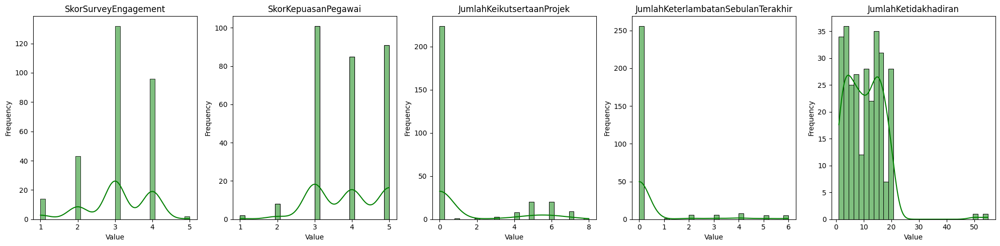

In [16]:
%matplotlib inline
# Histogram univariate analysis
df_univ = df_eda.drop(columns=['EnterpriseID', 'Username', 'NomorHP', 'Email', 'TanggalLahir', 'TanggalHiring', 'TanggalPenilaianKaryawan', 'TanggalResign'])
numerical_cols = df_univ.select_dtypes(['float64', 'int64']).columns

num_cols = 5
num_rows = (len(numerical_cols) // num_cols) + (len(numerical_cols) % num_cols > 0)

plt.figure(figsize=(20, num_rows * 5))

for i, col in enumerate(numerical_cols):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.histplot(df_univ[col], bins=30, kde=True, color='green')
    plt.title(col)
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.tight_layout() 
plt.savefig('Histogram univariate analysis.png', dpi=300, bbox_inches='tight')

plt.show()

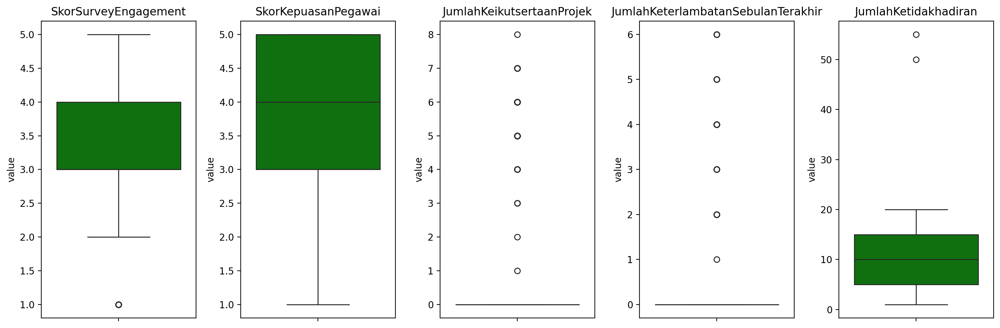

In [17]:
# Boxplot univariate analysis
num_cols = 5
num_rows = (len(numerical_cols) // num_cols) + (len(numerical_cols) % num_cols > 0)

plt.figure(figsize=(15, num_rows * 5), dpi=200)

for i, col in enumerate(numerical_cols):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.boxplot(y=df_univ[col], color='green')
    plt.title(col)
    plt.ylabel('value')
    plt.tight_layout() 
plt.savefig('Boxplot univariate analysis.png', dpi=300, bbox_inches='tight')

plt.show()

**Findings on numerical features:**
- There is outlier on SkorSurveyEngagement.
- There are some outliers on JumlahKeikutsertaanProjek, JumlahKeterlambatanSebulanTerakhir, dan JumlahKetidakhadiran but looks likely not some anomalies because the scale is reasonable.

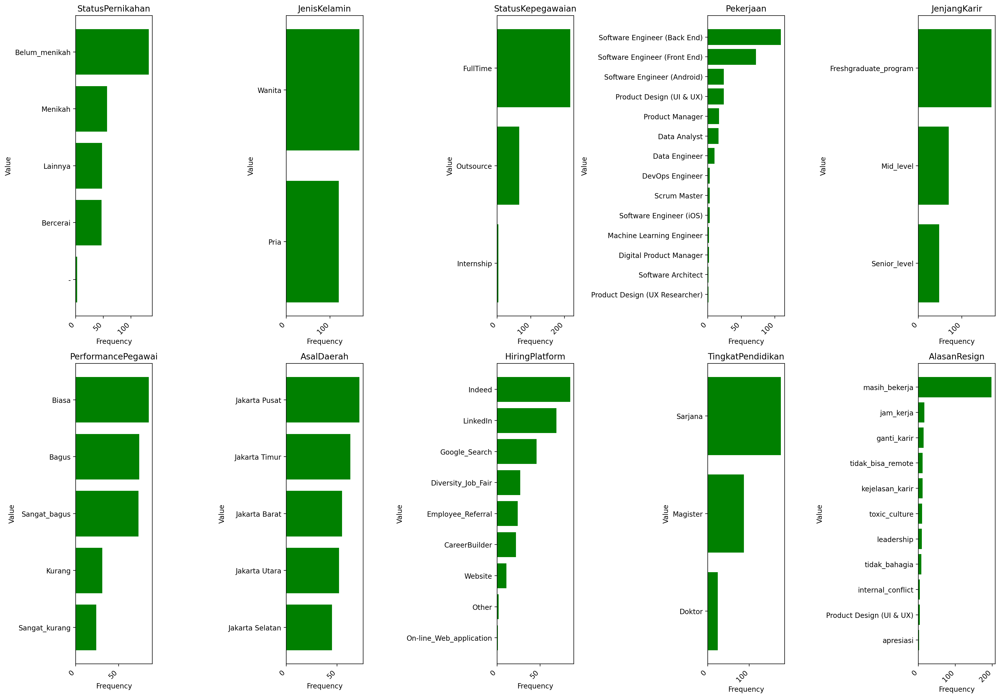

In [18]:
df_countplot = df_eda.drop(columns=['EnterpriseID', 'Username', 'NomorHP', 'Email', 'TanggalLahir', 'TanggalHiring', 'TanggalPenilaianKaryawan', 'TanggalResign'])
columns_to_category = ['StatusPernikahan', 'JenisKelamin', 'StatusKepegawaian', 'Pekerjaan', 'JenjangKarir', 'PerformancePegawai', 'AsalDaerah', 'HiringPlatform',
            'TingkatPendidikan', 'AlasanResign']

#for columns in columns_to_category:
#        df_countplot[columns] = df_countplot[columns].map({0: 'No', 1: 'Yes'})

categorical_cols = df_countplot.select_dtypes(['object']).columns
num_cols = 5
num_rows = (len(categorical_cols) // num_cols) + (len(categorical_cols) % num_cols > 0)

plt.figure(figsize=(20, num_rows * 7), dpi=200)

for i, col in enumerate(categorical_cols):
    plt.subplot(num_rows, num_cols, i + 1)
    value_counts = df_countplot[col].value_counts(ascending=True)
    plt.barh(value_counts.index, value_counts.values, color='green')
    plt.title(col)
    plt.xlabel('Frequency')
    plt.ylabel('Value')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout() 
plt.savefig('Countplot univariate analysis.png', dpi=300, bbox_inches='tight')

plt.show()

**Findings on categorical features:**
- Marriage status, Employee's status, Career Path, and Resign Reason tend to have a high dominant value between their other values.
- The rest are not likely to have anomaly.

# Multivariate Analysis

In [19]:
df_eda.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287 entries, 0 to 286
Data columns (total 23 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Username                            287 non-null    object 
 1   EnterpriseID                        287 non-null    int64  
 2   StatusPernikahan                    287 non-null    object 
 3   JenisKelamin                        287 non-null    object 
 4   StatusKepegawaian                   287 non-null    object 
 5   Pekerjaan                           287 non-null    object 
 6   JenjangKarir                        287 non-null    object 
 7   PerformancePegawai                  287 non-null    object 
 8   AsalDaerah                          287 non-null    object 
 9   HiringPlatform                      287 non-null    object 
 10  SkorSurveyEngagement                287 non-null    int64  
 11  SkorKepuasanPegawai                 287 non-n

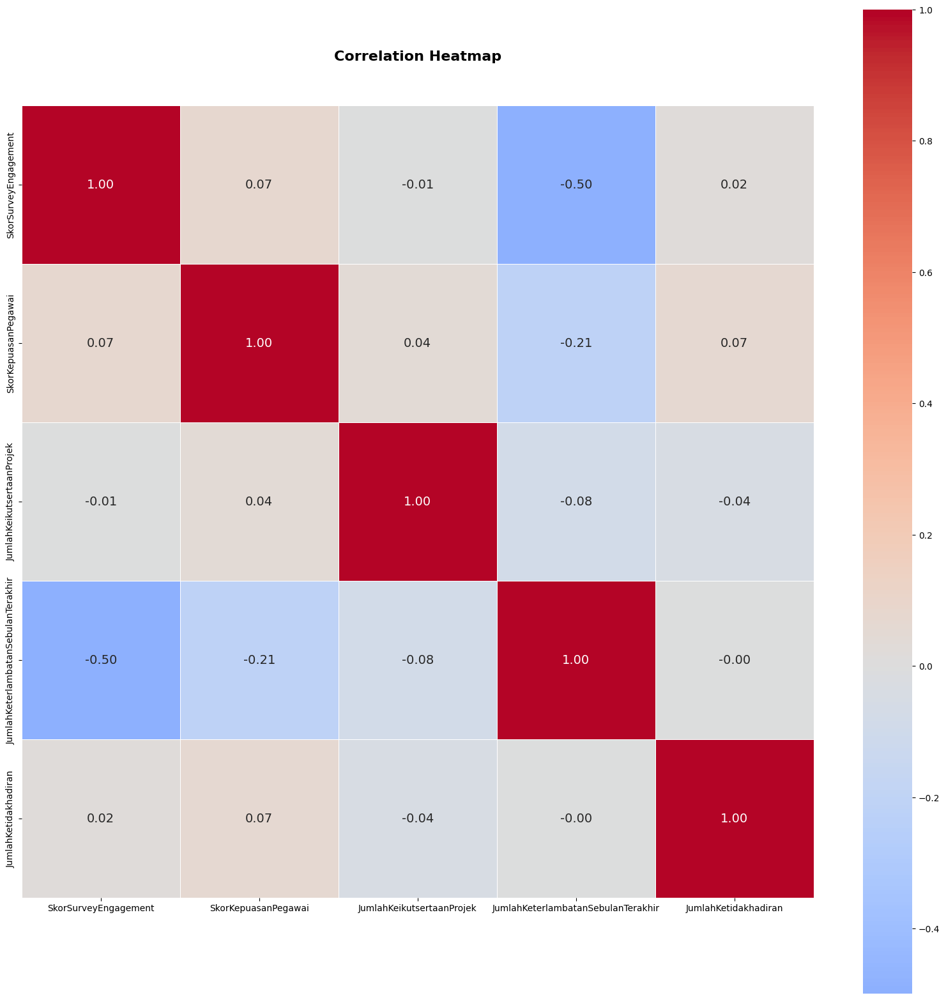


Pasangan fitur dengan korelasi tinggi (>0.7):


In [20]:
numerical_cols = ['SkorSurveyEngagement', 'SkorKepuasanPegawai', 'JumlahKeikutsertaanProjek', 'JumlahKeterlambatanSebulanTerakhir', 'JumlahKetidakhadiran']
plt.figure(figsize=(20, 20))
correlation_matrix = df_eda[numerical_cols].corr(method='pearson')
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, fmt='.2f', square=True, linewidths=0.5, annot_kws={'size': 14},
            xticklabels=correlation_matrix.columns, yticklabels=correlation_matrix.columns)
plt.title('Correlation Heatmap', fontweight='bold', fontsize = 16, y=1.05)
#plt.tight_layout()
plt.savefig("Correlation Heatmap", dpi=300, bbox_inches='tight')
plt.show()
plt.close()

threshold = 0.7
high_corr_features = np.where(np.abs(correlation_matrix) > threshold)
high_corr_features = [(correlation_matrix.index[x], correlation_matrix.columns[y], correlation_matrix.iloc[x,y]) 
                      for x, y in zip(*high_corr_features) if x != y and x < y]

print("\nPasangan fitur dengan korelasi tinggi (>0.7):")
for feat1, feat2, corr in high_corr_features:
    print(f"{feat1} - {feat2}: {corr:.2f}")

**Findings:**
- SkorSurveyEngagement has a moderate negative correlation (-0.50) with JumlahKeterlambatanSebulanTerakhir, meaning the higher SkorSurveyEngagement, the lower they likely to absences.
- JumlahketerlambatanSebulanTerakhir also has a slightly negative correlation (-0.21) with SkorKepuasanPegawai, suggesting the satisfied employee will less likely to late within a month.

# Data Analysis

## Employees Overview 2006 - 2020

In [21]:
df_eda["Tahun_Hiring"] = df_eda["TanggalHiring"].map(lambda x: x[:4])
df_waterfall_hire = df_eda.groupby(["Tahun_Hiring"])["EnterpriseID"].count().reset_index()
df_waterfall_hire["Tahun_Hiring"] = df_waterfall_hire["Tahun_Hiring"].astype(str)


df_eda["Tahun_Resign"] = df_eda["TanggalResign"].map(lambda x: x[:4] if x != "-" else "-")
df_waterfall_resign = df_eda.groupby(["Tahun_Resign"])["EnterpriseID"].count().reset_index()
df_waterfall_resign["Tahun_Resign"] = df_waterfall_resign["Tahun_Resign"].astype(str)
df_waterfall_resign = df_waterfall_resign[df_waterfall_resign["Tahun_Resign"]!="-"]

df_plot_waterfall = pd.merge(left = df_waterfall_hire, 
                             right = df_waterfall_resign,
                             how="outer",
                             right_on="Tahun_Resign",
                             left_on= "Tahun_Hiring")

df_plot_waterfall = df_plot_waterfall[["Tahun_Hiring","Tahun_Resign","EnterpriseID_x","EnterpriseID_y"]].fillna(0)
df_plot_waterfall.columns = ["Tahun_Hiring","Tahun_Resign","total_hired","total_resigned"]
df_plot_waterfall["Tahun_Hiring"] = list(range(2006,2021,1))


df_plot_waterfall["total_karyawan"] = df_plot_waterfall["total_hired"].cumsum() - df_plot_waterfall["total_resigned"]
df_plot_waterfall["changed"] = df_plot_waterfall["total_hired"] - df_plot_waterfall["total_resigned"]
df_plot_waterfall

,Tahun_Hiring,Tahun_Resign,total_hired,total_resigned,total_karyawan,changed
0,2006,0,1.0,0.0,1.0,1.0
1,2007,0,2.0,0.0,3.0,2.0
2,2008,0,2.0,0.0,5.0,2.0
3,2009,0,7.0,0.0,12.0,7.0
4,2010,0,8.0,0.0,20.0,8.0
5,2011,0,76.0,0.0,96.0,76.0
6,2012,0,41.0,0.0,137.0,41.0
7,2013,2013,43.0,5.0,175.0,38.0
8,2014,2014,56.0,12.0,224.0,44.0
9,2015,2015,31.0,8.0,259.0,23.0


In [22]:
# Import the necessaries libraries
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objects as go

# Set notebook mode to work in offline
pyo.init_notebook_mode()

In [23]:
import plotly.graph_objects as go

layout = go.Layout(
    title="Employee Count Dynamics: Annual Overview (2006 - 2021)",
    showlegend=False,
    yaxis=dict(title='Total Employee'),
    xaxis=dict(title='Year'),
    width=1200,  # Increase width
    height=600,  # Increase height
    margin=dict(l=50, r=50, t=100, b=50)  # Adjust margins if needed
)

all_employees = int(df_plot_waterfall["total_hired"].sum() - df_plot_waterfall["total_resigned"].sum())

fig = go.Figure(go.Waterfall(
    name="20", orientation="v",
    measure=["relative" for x in range(len(df_plot_waterfall["changed"]))] + ["total"],
    x=df_plot_waterfall["Tahun_Hiring"].tolist() + [2021],
    textposition="outside",
    text=[str(x) if x <= 0 else "+" + str(x) for x in df_plot_waterfall["changed"]] + [str(all_employees)],
    y=df_plot_waterfall["changed"].tolist() + [str(all_employees)],
    connector={"line": {"color": "rgb(63, 63, 63)", "dash": "solid"}},
), 
layout=layout)

fig.show()


In [24]:
print(df_plot_waterfall["Tahun_Resign"].dtype)
df_plot_waterfall["Tahun_Resign"] = df_plot_waterfall["Tahun_Resign"].replace("O", 0)

# Change all datatypes to int
cols = df_plot_waterfall.columns.tolist()
df_plot_waterfall[cols] = df_plot_waterfall[cols].astype(int)
df_plot_waterfall.info()

object
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15 entries, 0 to 14
Data columns (total 6 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   Tahun_Hiring    15 non-null     int64
 1   Tahun_Resign    15 non-null     int64
 2   total_hired     15 non-null     int64
 3   total_resigned  15 non-null     int64
 4   total_karyawan  15 non-null     int64
 5   changed         15 non-null     int64
dtypes: int64(6)
memory usage: 852.0 bytes


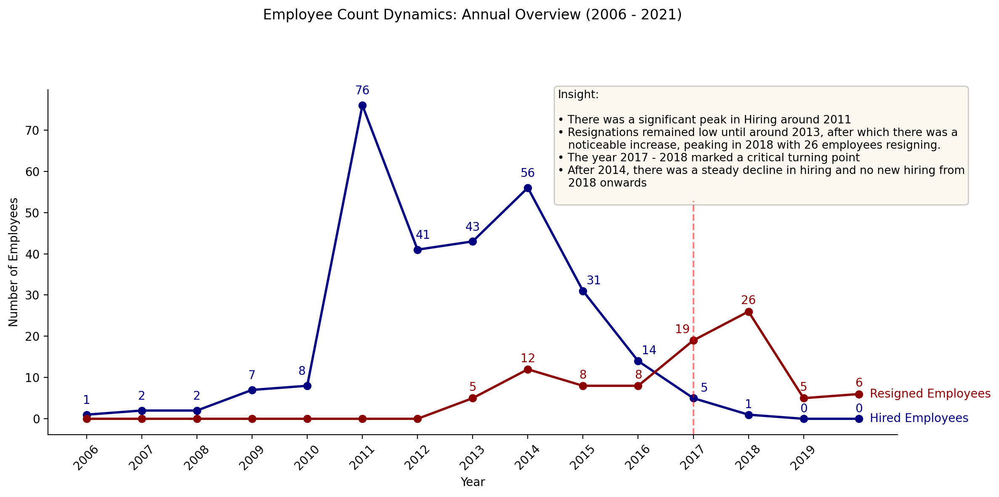

In [25]:
# Create figure with extra space for text labels
plt.figure(figsize=(12, 6), dpi=200)

# Plot hiring data
plt.plot(df_plot_waterfall['Tahun_Hiring'], 
         df_plot_waterfall['total_hired'], 
         color='navy', 
         marker='o',
         linewidth=2)

# Add value labels for hiring line
for year, value in zip(df_plot_waterfall['Tahun_Hiring'], df_plot_waterfall['total_hired']):
    if year >= 2018:
        plt.text(year, value + 1, str(value), ha='center', va='bottom', color='navy')    
    elif year == 2017:
        plt.text(year + 0.2, value + 1, str(value), ha='center', va='bottom', color='navy')
    elif year >= 2015:
        plt.text(year + 0.2, value + 1, str(value), ha='center', va='bottom', color='navy')
    elif year >= 2013:
        plt.text(year, value + 2, str(value), ha='center', va='bottom', color='navy')
    elif year >= 2012:
        plt.text(year + 0.1, value + 2, str(value), ha='center', va='bottom', color='navy')
    elif year >= 2011:
        plt.text(year, value + 2, str(value), ha='center', va='bottom', color='navy')
    elif year >= 2011:
        plt.text(year, value + 2, str(value), ha='center', va='bottom', color='navy')
    elif year >= 2010:
        plt.text(year - 0.1, value + 2, str(value), ha='center', va='bottom', color='navy')
    else:
        plt.text(year, value + 2, str(value), ha='center', va='bottom', color='navy')

# Plot resigning data
plt.plot(df_plot_waterfall['Tahun_Hiring'], 
         df_plot_waterfall['total_resigned'], 
         color='darkred', 
         marker='o',
         linewidth=2)

# Add value labels for resigning line
for year, value in zip(df_plot_waterfall['Tahun_Resign'], df_plot_waterfall['total_resigned']):
    if year >= 2018:
        plt.text(year, value + 4, str(value), ha='center', va='top', color='darkred')
    elif year == 2017:
        plt.text(year - 0.2, value + 4, str(value), ha='center', va='top', color='darkred')
    elif year >= 2016:
        plt.text(year, value + 4, str(value), ha='center', va='top', color='darkred')
    elif year >= 2009:
        plt.text(year, value + 4, str(value), ha='center', va='top', color='darkred')

# Add vertical line for 2017
ymin, ymax = plt.ylim()
y_norm = 54 / ymax
plt.axvline(x=2017, ymin=0, ymax= y_norm, color='red', linestyle='--', alpha=0.5)

# Customize axes
plt.xlabel('Year', fontsize=10)
plt.ylabel('Number of Employees', fontsize=10)
plt.xticks(range(2006, 2020, 1), rotation=45)

# Add title
plt.title('Employee Count Dynamics: Annual Overview (2006 - 2021)', 
          pad=60)

# Adding Description
desc_text = (
    'Insight:\n\n'
    f"• There was a significant peak in Hiring around 2011\n"
    f'• Resignations remained low until around 2013, after which there was a\n   noticeable increase, peaking in 2018 with 26 employees resigning.\n'
    f'• The year 2017 - 2018 marked a critical turning point\n'
    f'• After 2014, there was a steady decline in hiring and no new hiring from\n   2018 onwards\n'
)


# Adding Box Description
props = dict(boxstyle='round', facecolor='wheat', alpha=0.2)
plt.text(0.6, 1, desc_text,
         transform=plt.gca().transAxes,
         fontsize=9.5,
         verticalalignment='top',
         bbox=props,
         )

# Add text labels at the end of each line
last_hire_year = df_plot_waterfall['Tahun_Hiring'].iloc[-1]
last_hire_value = df_plot_waterfall['total_hired'].iloc[-1]
last_resign_year = df_plot_waterfall['Tahun_Resign'].iloc[-1]
last_resign_value = df_plot_waterfall['total_resigned'].iloc[-1]

plt.text(last_hire_year + 0.2, last_hire_value, 'Hired Employees', 
         color='navy', verticalalignment='center')
plt.text(last_resign_year + 0.2, last_resign_value, 'Resigned Employees', 
         color='darkred', verticalalignment='center')


sns.despine()
plt.tight_layout()
#plt.savefig('Annual Report on Employee Number Changes', dpi=200, bbox_inches='tight')
plt.show()


Based on the annual report on employee number changes from 2006 to 2020, several insights and recommendations can be derived:

**Insights**
1. Hiring Peak in 2011:
- A significant increase in hiring was observed in **2011**, with 76 new employees being brought on board. This indicates a period of expansion or increased demand for workforce.
2. Low Resignations Until 2013:
- Resignations remained minimal until around **2013**, suggesting employee satisfaction or stability during this period.
3. Increase in Resignations Post-2013:
- Starting in 2013, resignations began to rise, peaking in **2018** with 26 employees leaving. This could indicate emerging issues such as dissatisfaction or better opportunities elsewhere.
4. Critical Turning Point in 2017-2018:
- The years **2017 to 2018** marked a critical turning point where the number of resignations surpassed new hires, indicating potential organizational challenges.
5. Decline in Hiring Post-2014:
- After **2014**, there was a noticeable decline in hiring, with no new hires from 2018 onwards, suggesting possible budget constraints or strategic shifts.

**Conclusion** <br>

In 2014, the company began to experience a decline in the hiring of new employees while retaining existing staff. The total number of employees reached its peak in 2016 with 248 individuals. However, by 2020, this number had decreased to 198 employees, representing a reduction of approximately 20.16%.

The reduction in total employees and the cessation of hiring from 2018 onwards may indicate underlying issues within the organization. The significant increase in resignations post-2013, coupled with the reduction in workforce size, suggests potential challenges such as employee dissatisfaction, financial constraints, or strategic restructuring.

Given these factors, the company may not be in a completely healthy state. It is crucial for the organization to address these issues promptly to ensure long-term stability and growth. Implementing strategies to improve employee retention, reassessing hiring practices, and closely monitoring industry trends will be essential steps in restoring organizational health.

## Resign Reason Analysis

In [26]:
# Aggregate resign vs not resign
df_resign = df_eda.copy()
df_resign['AlasanResign'] = df_resign['AlasanResign'].fillna('masih_bekerja')
# Filtering Resigned employee
df_resign['is_resign'] = df_resign['AlasanResign'].apply(lambda x: 0 if x == 'masih_bekerja' else 1)
df_resign['is_resign'] = df_resign['is_resign'].astype('int64')
# Make the dataframees
employee_resign = df_resign[df_resign['is_resign'] == 1].groupby('Pekerjaan').size().reset_index(name='Jumlah_Resign')
employee_current = df_resign[df_resign['is_resign'] == 0].groupby('Pekerjaan').size().reset_index(name='Jumlah_Masih_Bekerja')

# Outer Join based on Pekerjaan
df_join = pd.merge(employee_current, employee_resign, on='Pekerjaan', how='outer')


In [27]:
employee_resign

,Pekerjaan,Jumlah_Resign
0,Data Analyst,8
1,Data Engineer,3
2,Product Design (UI & UX),9
3,Product Manager,6
4,Software Engineer (Android),7
5,Software Engineer (Back End),28
6,Software Engineer (Front End),28


In [28]:
employee_current

,Pekerjaan,Jumlah_Masih_Bekerja
0,Data Analyst,8
1,Data Engineer,7
2,DevOps Engineer,3
3,Digital Product Manager,2
4,Machine Learning Engineer,2
5,Product Design (UI & UX),15
6,Product Design (UX Researcher),1
7,Product Manager,11
8,Scrum Master,3
9,Software Architect,1


In [29]:
df_join['Jumlah_Masih_Bekerja'] = df_join['Jumlah_Masih_Bekerja'].astype('Int32')
df_join['Jumlah_Resign'] = df_join['Jumlah_Resign'].astype('Int32')
df_join = df_join.fillna(0)
df_join

,Pekerjaan,Jumlah_Masih_Bekerja,Jumlah_Resign
0,Data Analyst,8,8
1,Data Engineer,7,3
2,DevOps Engineer,3,0
3,Digital Product Manager,2,0
4,Machine Learning Engineer,2,0
5,Product Design (UI & UX),15,9
6,Product Design (UX Researcher),1,0
7,Product Manager,11,6
8,Scrum Master,3,0
9,Software Architect,1,0


## Employee Retention and Resignation Table by Job Role

In [30]:
df_join['Total_Employees'] = df_join['Jumlah_Masih_Bekerja'] + df_join['Jumlah_Resign']
df_join['Percentage_Resign'] = round(df_join['Jumlah_Resign'] / df_join['Total_Employees'], 2)*100
df_join['Percentage_Masih_Bekerja'] = round(df_join['Jumlah_Masih_Bekerja'] / df_join['Total_Employees'], 2)*100
df_join['Percentage_Resign'] = df_join['Percentage_Resign'].astype('Int32')
df_join['Percentage_Masih_Bekerja'] = df_join['Percentage_Masih_Bekerja'].astype("Int32")
df_join

,Pekerjaan,Jumlah_Masih_Bekerja,Jumlah_Resign,Total_Employees,Percentage_Resign,Percentage_Masih_Bekerja
0,Data Analyst,8,8,16,50,50
1,Data Engineer,7,3,10,30,70
2,DevOps Engineer,3,0,3,0,100
3,Digital Product Manager,2,0,2,0,100
4,Machine Learning Engineer,2,0,2,0,100
5,Product Design (UI & UX),15,9,24,38,62
6,Product Design (UX Researcher),1,0,1,0,100
7,Product Manager,11,6,17,35,65
8,Scrum Master,3,0,3,0,100
9,Software Architect,1,0,1,0,100


## Employee Retention by Job Division

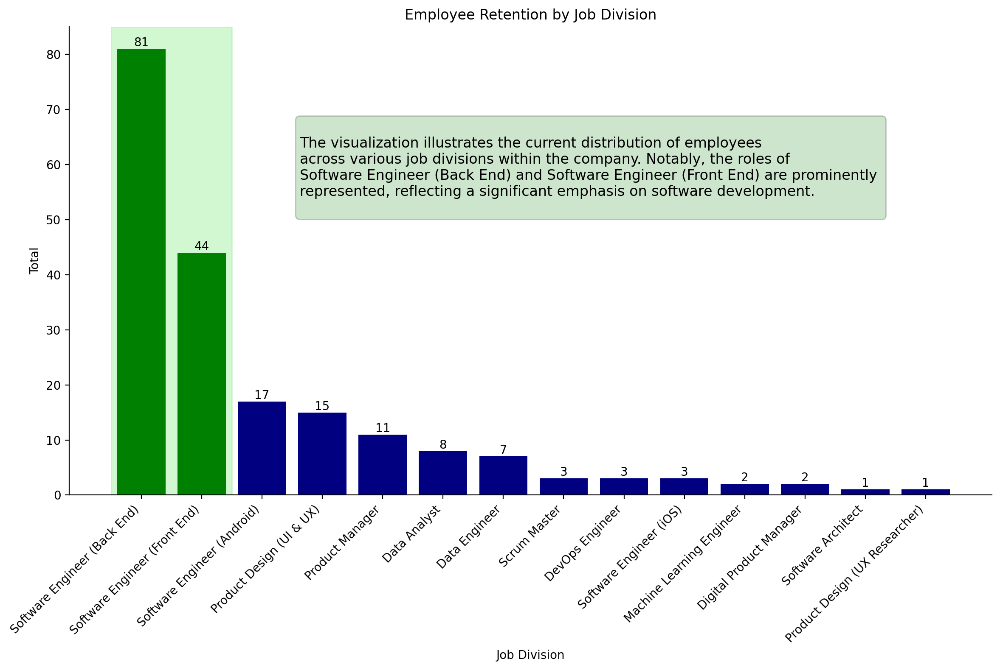

In [31]:
# Employee Retention by Job Division

df_viz = df_join.copy()
df_viz = df_viz.sort_values(by='Jumlah_Masih_Bekerja', ascending=False)
# Plot 
plt.figure(figsize=(12, 8), dpi=200)
plt.axvspan(-0.5, 1.5, color='lightgreen', alpha=0.4)
# Bar Plot
top_two_values = df_viz['Jumlah_Masih_Bekerja'].nlargest(2).values
colors = ['green' if x in top_two_values else 'navy' for x in df_viz['Jumlah_Masih_Bekerja']]
plt.bar(df_viz['Pekerjaan'], df_viz['Jumlah_Masih_Bekerja'], color=colors)

# Add percentage values on top of bars
for index, value in enumerate(df_viz['Jumlah_Masih_Bekerja']):
    plt.text(index, value, f'{value:.0f}', ha='center', va='bottom')

# Adding Description
desc_text = (
    """\nThe visualization illustrates the current distribution of employees
across various job divisions within the company. Notably, the roles of 
Software Engineer (Back End) and Software Engineer (Front End) are prominently 
represented, reflecting a significant emphasis on software development.\n"""
    )

# Adding Box Description
props = dict(boxstyle='round', facecolor='green', alpha=0.2)
plt.text(0.25, 0.8, desc_text,
         transform=plt.gca().transAxes,
         fontsize=12,
         verticalalignment='top',
         bbox=props,
         )

# Customize plot
plt.title('Employee Retention by Job Division')
plt.xlabel('Job Division')
plt.xticks(rotation=45, ha='right')
plt.ylabel('Total')

sns.despine()
plt.tight_layout()
plt.savefig('Employee Retention by Job Division', dpi=200, bbox_inches='tight')
plt.show()

## Employee Resignation by Job Division

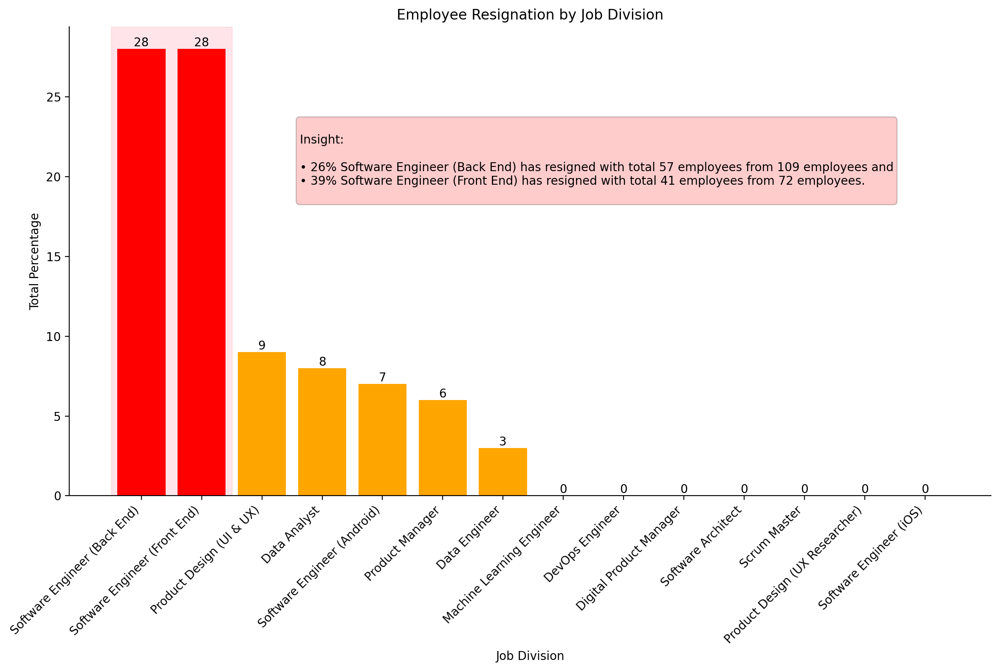

In [32]:
df_viz = df_join.copy()
df_viz = df_viz.sort_values(by='Jumlah_Resign', ascending=False)
top_two_values = df_viz['Jumlah_Resign'].nlargest(2).values

# Plot 
plt.figure(figsize=(12, 8), dpi=200)
plt.axvspan(-0.5, 1.5, color='pink', alpha=0.4)
# Plot bars with conditional coloring
colors = ['red' if x in top_two_values else 'orange' for x in df_viz['Jumlah_Resign']]
plt.bar(df_viz['Pekerjaan'], df_viz['Jumlah_Resign'], color=colors)

# Add percentage values on top of bars
for index, value in enumerate(df_viz['Jumlah_Resign']):
    plt.text(index, value, f'{value:.0f}', ha='center', va='bottom')

# Adding Description
desc_text = (
    '\nInsight: \n\n'
    f"• 26% Software Engineer (Back End) has resigned with total 57 employees from 109 employees and\n"
    f"• 39% Software Engineer (Front End) has resigned with total 41 employees from 72 employees.\n"
    )

# Adding Box Description
props = dict(boxstyle='round', facecolor='red', alpha=0.2)
plt.text(0.25, 0.8, desc_text,
         transform=plt.gca().transAxes,
         fontsize=10,
         verticalalignment='top',
         bbox=props,
         )

# Customize plot
plt.title('Employee Resignation by Job Division')
plt.xlabel('Job Division')
plt.xticks(rotation=45, ha='right')
plt.ylabel('Total Percentage')

sns.despine()
plt.tight_layout()
plt.savefig('Employee Resignation by Job Division', dpi=200, bbox_inches='tight')
plt.show()

**Findings:**

- The job divisions of **Software Engineer (Back End)** and **Software Engineer (Front End)** have the highest employee retention numbers, with 81 and 44 employees respectively, indicating these roles are the most staffed within the company.
- Other job divisions have significantly fewer employees retained, with counts ranging from 17 down to just 1 in some specialized roles like Software Architect and Product Design (UX Researcher).
- In terms of resignation percentages, both **Software Engineer (Back End)** and **Software Engineer (Front End)** show the highest resignation rates at 28% each.
- The resignation rate for other job divisions is considerably lower, mostly under 10%, with several roles showing zero resignations.
- Specifically:
   - About 26% of Software Engineers (Back End) resigned, which corresponds to 57 resignations out of a total of 109 employees in that division.
   - Approximately 39% of Software Engineers (Front End) resigned, totaling 41 resignations from a workforce of 72 employees in that division.
- This data suggests that while software engineering roles dominate staffing levels, they also experience relatively high turnover compared to other departments.

## Employee Resignation by Career Path, Employee's performance, and Resignation Reason on Back End and Front End Software Engineer

In [33]:
df_sunburst_backend = df_eda.query("Pekerjaan == 'Software Engineer (Back End)'").groupby(["JenjangKarir","PerformancePegawai","AlasanResign"]).count()["EnterpriseID"].reset_index()
print('Software Engineer (Back End) Data:')
df_sunburst_backend

Software Engineer (Back End) Data:


,JenjangKarir,PerformancePegawai,AlasanResign,EnterpriseID
0,Freshgraduate_program,Bagus,kejelasan_karir,1
1,Freshgraduate_program,Bagus,masih_bekerja,11
2,Freshgraduate_program,Bagus,toxic_culture,1
3,Freshgraduate_program,Biasa,ganti_karir,2
4,Freshgraduate_program,Biasa,jam_kerja,1
5,Freshgraduate_program,Biasa,kejelasan_karir,1
6,Freshgraduate_program,Biasa,leadership,1
7,Freshgraduate_program,Biasa,masih_bekerja,19
8,Freshgraduate_program,Biasa,tidak_bisa_remote,1
9,Freshgraduate_program,Kurang,ganti_karir,1


In [34]:
df_sunburst_frontend = df_eda.query("Pekerjaan == 'Software Engineer (Front End)'").groupby(["JenjangKarir","PerformancePegawai","AlasanResign"]).count()["EnterpriseID"].reset_index()
print('Software Engineer (Front End) Data:')
df_sunburst_frontend

Software Engineer (Front End) Data:


,JenjangKarir,PerformancePegawai,AlasanResign,EnterpriseID
0,Freshgraduate_program,Bagus,jam_kerja,2
1,Freshgraduate_program,Bagus,masih_bekerja,10
2,Freshgraduate_program,Bagus,tidak_bisa_remote,1
3,Freshgraduate_program,Biasa,apresiasi,1
4,Freshgraduate_program,Biasa,kejelasan_karir,1
5,Freshgraduate_program,Biasa,masih_bekerja,5
6,Freshgraduate_program,Biasa,tidak_bisa_remote,1
7,Freshgraduate_program,Kurang,masih_bekerja,4
8,Freshgraduate_program,Sangat_bagus,Product Design (UI & UX),1
9,Freshgraduate_program,Sangat_bagus,masih_bekerja,11


In [35]:
plt.figure(figsize=(16, 10))

custom_colors = {
     'freshgraduate_program': '#636EFA',
     'Mid_level': '#EF553B',
     'Senior_level': '#00CC96'
}

fig = px.sunburst(
    df_sunburst_backend,
    path=['JenjangKarir', 'PerformancePegawai', 'AlasanResign'],
    values='EnterpriseID',
    color='JenjangKarir',
    color_discrete_map=custom_colors,
    title="Total Employee on Software Engineer (Back End): Based on career level, performance, and resignation reason",
    width=1200,
    height=800)

fig.update_layout(
    title_font=dict(size=20),
    font=dict(size=14))
fig.show()


<Figure size 1600x1000 with 0 Axes>

In [36]:
plt.figure(figsize=(16, 10))

fig = px.sunburst(
    df_sunburst_frontend,
    path=['JenjangKarir', 'PerformancePegawai', 'AlasanResign'],
    values='EnterpriseID',
    title="Total Employee on Software Engineer (Front End): Based on career level, performance, and resignation reason",
    width=1200,
    height=800)

fig.update_layout(
    title_font=dict(size=20),
    font=dict(size=14))
fig.show()


<Figure size 1600x1000 with 0 Axes>

## Resign Percentage Based on Position and Resign Reason

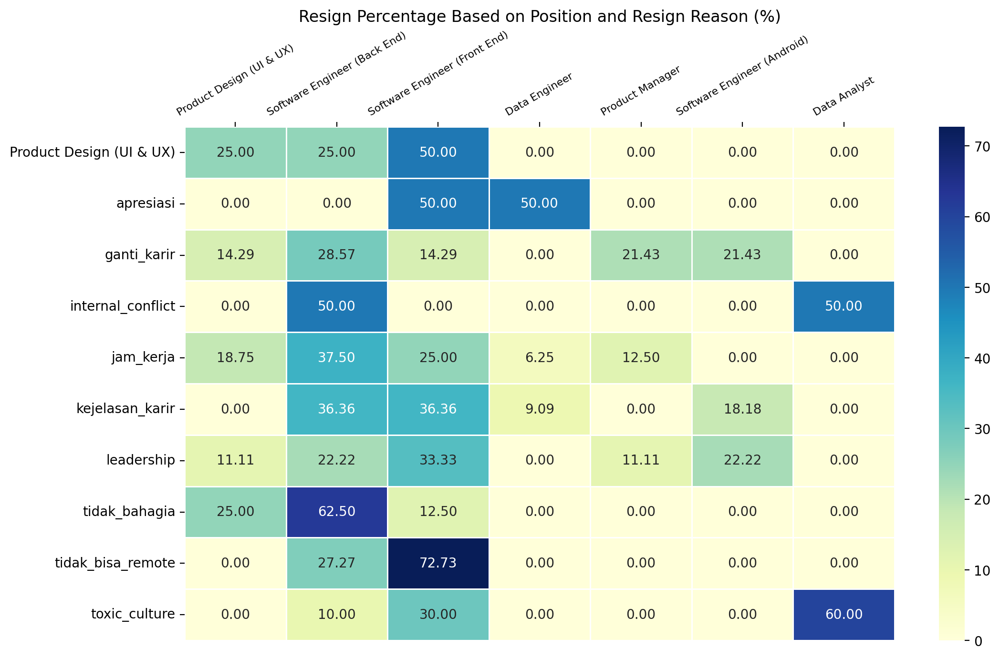

In [37]:
df_score = df_resign.query("is_resign==1").groupby(["AlasanResign","Pekerjaan"])["EnterpriseID"].count().reset_index()

review_matrix = []
performance_sort = df_score["Pekerjaan"].unique()
for x in df_score["AlasanResign"].unique():
    temp_df = df_score[df_score["AlasanResign"]==x].set_index("Pekerjaan")["EnterpriseID"].reindex(performance_sort).fillna(0)
    temp_vector = [int(x) for x in temp_df.reset_index()["EnterpriseID"]]
    review_matrix.append(temp_vector)
    
#store as data frame
review_pivot = pd.DataFrame(review_matrix,columns=performance_sort,index=df_score["AlasanResign"].unique())
division_list = np.sum(review_pivot,axis=1).reset_index()[0].tolist()
for index,value in enumerate(review_pivot.index):
    review_pivot.loc[value] = round(100.00*review_pivot.loc[value]/division_list[index],2)

# Create Plot
plt.figure(figsize=(12,7), dpi=200)
ax = sns.heatmap(review_pivot, linewidths=.5, annot=True, fmt=',.02f', cmap="YlGnBu", cbar=True)
ax.xaxis.set_ticks_position('top')
ax.set_xticklabels(ax.get_xticklabels(), rotation = 30, fontsize = 8)
ax.set_ylabel('')    
ax.set_xlabel('')
ax.set_title("Resign Percentage Based on Position and Resign Reason (%)")
plt.show()

**Findings:**
- The top resign for Software Engineer (back End) due to not happy working there and some internal conflict. The rest is because switch career, working hours, career path, leadership, can not work remotely, and toxic culture.
- While the Software Engineer (front End) have different top resign, most of them resign because of can not work remotely, lack of appreciation, and Product Deisgn (UI & UX). the rest is same as Back End Software Engineer but no sign of internal conflict that make them resign.
- As for Data Analyst, their reason to resign are because toxic culture and internal conflict.
- Data Engineer feel their work are not appreciated.
- As for the rest reason, most of people resign in every role are because **switch career, working hour, career path, and leadership**.

# Data Preprocessing

We want to predict which features that will make a person to resign, but we do not have resign features so we should create one.

## Feature Engineering

In [38]:
df_processed = df_cleaned.copy()
df_processed.columns

Index(['Username', 'EnterpriseID', 'StatusPernikahan', 'JenisKelamin',
       'StatusKepegawaian', 'Pekerjaan', 'JenjangKarir', 'PerformancePegawai',
       'AsalDaerah', 'HiringPlatform', 'SkorSurveyEngagement',
       'SkorKepuasanPegawai', 'JumlahKeikutsertaanProjek',
       'JumlahKeterlambatanSebulanTerakhir', 'JumlahKetidakhadiran', 'NomorHP',
       'Email', 'TingkatPendidikan', 'AlasanResign', 'TanggalLahir',
       'TanggalHiring', 'TanggalPenilaianKaryawan', 'TanggalResign'],
      dtype='object')

In [39]:
df_processed["is_Resign"] = df["TanggalResign"].map(lambda x: 1 if x != "-" else x)
df_processed["is_Resign"].value_counts()

is_Resign
-    198
1     89
Name: count, dtype: int64

In [40]:
df_processed["is_Resign"] = df_processed["is_Resign"].replace("-", 0)
df_processed["is_Resign"].value_counts()

is_Resign
0    198
1     89
Name: count, dtype: int64

In [41]:
df_processed["keikutsertaanproject_boolean"] = df_processed["JumlahKeikutsertaanProjek"].map(lambda x: 1 if x!=0 else 0)
df_processed["Tahun_Hiring"] = df_processed["TanggalHiring"].map(lambda x: x[:4])
df_processed["Tahun_Resign"] = df_processed["TanggalResign"].map(lambda x: x[:4] if x != "-" else "-")
df_processed["lama_bekerja"] = df_processed["Tahun_Resign"].map(lambda x: 0 if x == "-" else x).astype(int) - df_processed["Tahun_Hiring"].astype(int)
df_processed["lama_bekerja"] = df_processed["lama_bekerja"].map(lambda x: 0 if x < 0 else x)
df_processed["usia_hired"] = df_processed["Tahun_Hiring"].astype(int) - df["TanggalLahir"].map(lambda x: int(x[:4])).astype(int)
df_processed["jarak_penilaian_tahun"] = df["TanggalPenilaianKaryawan"].map(lambda x: int(x[:4])).astype(int) - df_processed["Tahun_Hiring"].astype(int)

df_processed[["usia_hired","lama_bekerja","jarak_penilaian_tahun"]].describe()

,usia_hired,lama_bekerja,jarak_penilaian_tahun
count,287.000000,287.000000,287.000000
mean,34.080139,1.254355,5.933798
std,8.854922,2.353715,2.339791
min,19.000000,0.000000,1.000000
25%,28.000000,0.000000,4.000000
50%,32.000000,0.000000,6.000000
75%,39.000000,1.000000,7.000000
max,63.000000,9.000000,14.000000


In [42]:
df_processed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287 entries, 0 to 286
Data columns (total 30 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   Username                            287 non-null    object 
 1   EnterpriseID                        287 non-null    int64  
 2   StatusPernikahan                    287 non-null    object 
 3   JenisKelamin                        287 non-null    object 
 4   StatusKepegawaian                   287 non-null    object 
 5   Pekerjaan                           287 non-null    object 
 6   JenjangKarir                        287 non-null    object 
 7   PerformancePegawai                  287 non-null    object 
 8   AsalDaerah                          287 non-null    object 
 9   HiringPlatform                      287 non-null    object 
 10  SkorSurveyEngagement                287 non-null    int64  
 11  SkorKepuasanPegawai                 287 non-n

## Check Missing Value and Duplicated Data

In [43]:
df_processed.drop(columns=['Username', 'NomorHP', 'Email'], axis=1, inplace=True)

Delete Username as primary key to avoid undetected duplicated data.

In [44]:
# Check Missing value
100 * (df_processed.isnull().sum() / df_processed.shape[0]).sort_values(ascending=False)

EnterpriseID                          0.0
StatusPernikahan                      0.0
JenisKelamin                          0.0
StatusKepegawaian                     0.0
Pekerjaan                             0.0
JenjangKarir                          0.0
PerformancePegawai                    0.0
AsalDaerah                            0.0
HiringPlatform                        0.0
SkorSurveyEngagement                  0.0
SkorKepuasanPegawai                   0.0
JumlahKeikutsertaanProjek             0.0
JumlahKeterlambatanSebulanTerakhir    0.0
JumlahKetidakhadiran                  0.0
TingkatPendidikan                     0.0
AlasanResign                          0.0
TanggalLahir                          0.0
TanggalHiring                         0.0
TanggalPenilaianKaryawan              0.0
TanggalResign                         0.0
is_Resign                             0.0
keikutsertaanproject_boolean          0.0
Tahun_Hiring                          0.0
Tahun_Resign                      

In [45]:
# Check Duplicated Data
df_processed.duplicated().sum()

np.int64(0)

The data has no missing value nor duplicated data

## Check Outliers

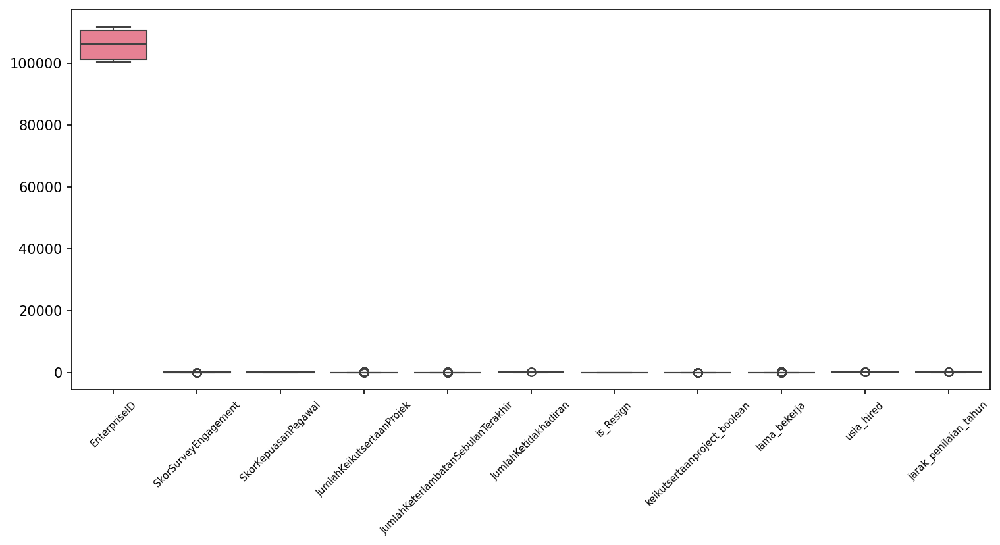

In [46]:
# Use Boxplot
df_numerical = df_processed.select_dtypes(include = ["int64","float64"])

# Figure Size Setting
plt.figure(figsize=(12,5), dpi=150)

# Boxplot using Seaborn
sns.boxplot(data=df_numerical,
            palette="husl")
plt.xticks(rotation=45, fontsize=7)
# Show the plot
plt.show()

In [47]:
df_numerical.describe()

,EnterpriseID,SkorSurveyEngagement,SkorKepuasanPegawai,JumlahKeikutsertaanProjek,JumlahKeterlambatanSebulanTerakhir,JumlahKetidakhadiran,is_Resign,keikutsertaanproject_boolean,lama_bekerja,usia_hired,jarak_penilaian_tahun
count,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000,287.000000
mean,105923.324042,3.101045,3.888502,1.167247,0.411150,10.439024,0.310105,0.219512,1.254355,34.080139,5.933798
std,4044.977599,0.836388,0.913060,2.285537,1.273018,6.829769,0.463344,0.414639,2.353715,8.854922,2.339791
min,100282.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,19.000000,1.000000
25%,101269.000000,3.000000,3.000000,0.000000,0.000000,5.000000,0.000000,0.000000,0.000000,28.000000,4.000000
50%,106069.000000,3.000000,4.000000,0.000000,0.000000,10.000000,0.000000,0.000000,0.000000,32.000000,6.000000
75%,110514.500000,4.000000,5.000000,0.000000,0.000000,15.000000,1.000000,0.000000,1.000000,39.000000,7.000000
max,111703.000000,5.000000,5.000000,8.000000,6.000000,55.000000,1.000000,1.000000,9.000000,63.000000,14.000000


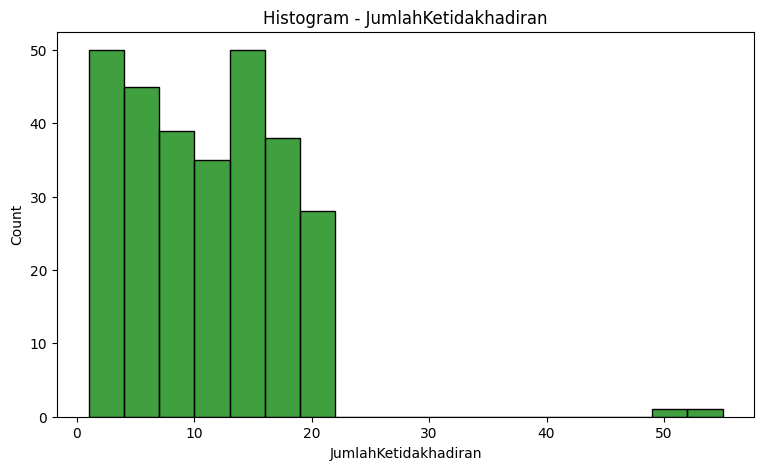

In [48]:
# Analysing Outliers on JumlahKetidakhadiran feature
col = 'JumlahKetidakhadiran'
plt.figure(figsize=(9, 5))
sns.histplot((df_numerical[col]),color='green')
plt.title(f'Histogram - {col}')
plt.show()

In [49]:
df_numerical[df_numerical['JumlahKetidakhadiran'] >= 50].sort_values('JumlahKetidakhadiran', ascending=False)

,EnterpriseID,SkorSurveyEngagement,SkorKepuasanPegawai,JumlahKeikutsertaanProjek,JumlahKeterlambatanSebulanTerakhir,JumlahKetidakhadiran,is_Resign,keikutsertaanproject_boolean,lama_bekerja,usia_hired,jarak_penilaian_tahun
115,106436,4,5.0,0.0,0.0,55.0,0,0,0,38,9
12,100895,4,3.0,0.0,0.0,50.0,0,0,0,25,7


In [50]:
df_numerical.columns

Index(['EnterpriseID', 'SkorSurveyEngagement', 'SkorKepuasanPegawai',
       'JumlahKeikutsertaanProjek', 'JumlahKeterlambatanSebulanTerakhir',
       'JumlahKetidakhadiran', 'is_Resign', 'keikutsertaanproject_boolean',
       'lama_bekerja', 'usia_hired', 'jarak_penilaian_tahun'],
      dtype='object')

**Analysis:**
- SkorSurveyEngagement has an outlier but we considered that this outlier is **not anomaly** because the range start from 1 to 5 and 1 is as outlier is acceptable.
- JumlahKeikutsertaanProjek has some outliers but when we look further, the range is 0 to 8, which mean it is **normal** if some employees take part of some projects while the average employees do not take part of the project.
- JumlahKeterlambatanSebulanTerakhir also has the same pattern with JumlahKeikutsertaanProjek, so we will consider the outliers as **not anomaly**.
- As for `JumlahKetidakhadiran`, there are two outliers found. But, looking at the length these employees had, they might at least 6 - 7 times absences per year. But, the number seems tend to high so we will consider these outliers as **anomaly**.
- keikutsertaanproject_boolean feature **does not show anomaly**.
- lama_bekerja feature shows the average of 1, meaning most of the employees had working within 1 year and we found some outliers but choose to **not drop** them because people who are working about 5 to 9 years seems reasonable.
- Usia_hired feature also shows **no anomaly** even though there are some outliers because looking at the range, the employees' age start from 19 to 63, which is still acceptable.
- We considered to **drop** `jarak_penilaian_tahun`'s outliers.

In [51]:
def handle_outliers_iqr(df, columns):
    df_handled = df.copy()

    for col in columns:
        Q1 = df_handled[col].quantile(0.25)
        Q3 = df_handled[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Replace outliers with lower or upper bounds
        df_handled[col] = np.where(
            df_handled[col] < lower_bound,
            lower_bound,
            np.where(
                df_handled[col] > upper_bound,
                upper_bound,
                df_handled[col]
            )
        )

    return df_handled

columns_to_handle = ['JumlahKetidakhadiran', 'jarak_penilaian_tahun']
df_handled = handle_outliers_iqr(df_processed, columns_to_handle)



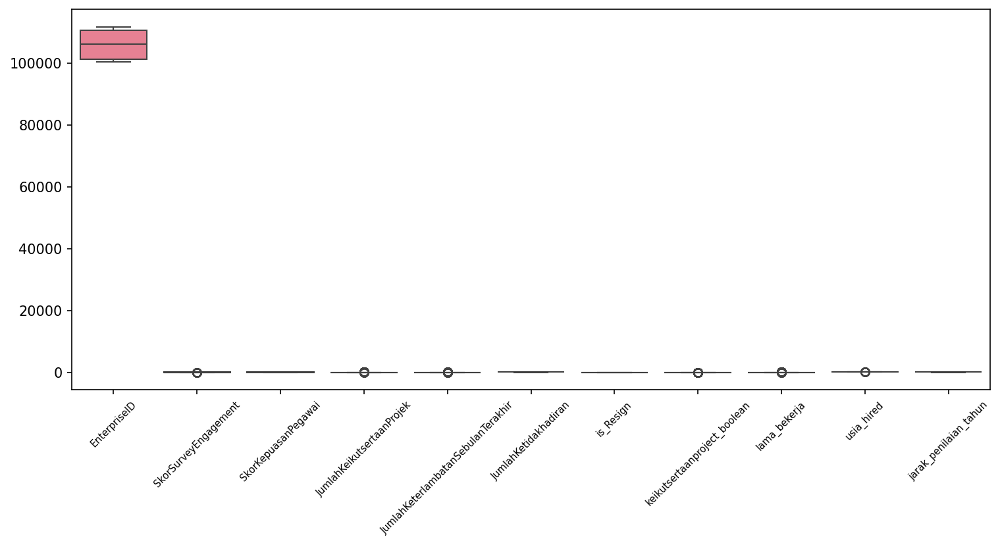

In [52]:
# Use Boxplot
df_numerical = df_handled.select_dtypes(include = ["int64","float64"])

# Figure Size Setting
plt.figure(figsize=(12,5), dpi=150)

# Boxplot using Seaborn
sns.boxplot(data=df_numerical,
            palette="husl")
plt.xticks(rotation=45, fontsize=7)
# Show the plot
plt.show()

## Feature Encoding

In [53]:
df_handled.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287 entries, 0 to 286
Data columns (total 27 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   EnterpriseID                        287 non-null    int64  
 1   StatusPernikahan                    287 non-null    object 
 2   JenisKelamin                        287 non-null    object 
 3   StatusKepegawaian                   287 non-null    object 
 4   Pekerjaan                           287 non-null    object 
 5   JenjangKarir                        287 non-null    object 
 6   PerformancePegawai                  287 non-null    object 
 7   AsalDaerah                          287 non-null    object 
 8   HiringPlatform                      287 non-null    object 
 9   SkorSurveyEngagement                287 non-null    int64  
 10  SkorKepuasanPegawai                 287 non-null    float64
 11  JumlahKeikutsertaanProjek           287 non-n

In [54]:
df_handled.drop(columns=['JenisKelamin', 'TanggalLahir', 'TanggalHiring', 'TanggalPenilaianKaryawan', 'TanggalResign', 'Tahun_Resign', 'Tahun_Hiring', 'AlasanResign'], axis=1, inplace=True)


In [55]:
# Data Repairing and Domain-Expertise Encoding
df_ml = df_handled.copy()

df_ml["StatusPernikahan"] = df_ml["StatusPernikahan"].map(lambda x: "Lainnya" if x == "-" else x)
df_ml["AsalDaerah"] = df_ml["AsalDaerah"].map(lambda x: x.replace(" ", "_"))

education_class = {"Sarjana": 1, 
                   "Magister": 2,
                   "Doktor": 3}
df_ml["TingkatPendidikan"] = df_ml["TingkatPendidikan"].map(education_class)

career_level = {"Freshgraduate_program": 1, 
                "Mid_level": 2,
                "Senior_level": 3}
df_ml["JenjangKarir"] = df_ml["JenjangKarir"].map(career_level)

performance_class = {"Sangat_kurang" : 1,
                     "Kurang" : 2,
                     "Biasa" : 3,
                     "Bagus" : 4,
                     "Sangat_bagus" : 5}
df_ml["PerformancePegawai"] = df_ml["PerformancePegawai"].map(performance_class)

# Working Division
engineering_div = ['Software Engineer (Back End)',
               'Software Engineer (Front End)',
               'Software Engineer (Android)',
               'Software Engineer (iOS)', 
               'DevOps Engineer', 
               'Software Architect', 
               'Machine Learning Engineer']
data_div = ['Data Analyst', 'Data Engineer']
product_div = ['Product Manager', 
               'Product Design (UX Researcher)', 
               'Product Design (UI & UX)', 
               'Digital Product Manager',
               'Scrum Master']

df_ml["Pekerjaan"] = df_ml["Pekerjaan"].map(lambda x: "engineering_division" if x in engineering_div else \
                                                       "data_division" if x in data_div else "product_division")
# Frequency Encoding
frequency_logic = df_ml.groupby("HiringPlatform").size()/len(df_ml)
df_ml["HiringPlatform_Encode"] = df_ml["HiringPlatform"].map(frequency_logic)
df_ml.drop(["HiringPlatform"],axis=1,inplace=True)

In [56]:
df_categorical = df_ml.select_dtypes(exclude = ["int64","float64"])
df_numerical = df_ml.select_dtypes(include = ["int64","float64"])

In [57]:
feature_labelencoding = []
feature_onehot = []
feature_frequency = []

# Iteration
for i in df_categorical.columns:
    test_loop = df_categorical[i].unique().tolist()
    print(test_loop)
    # Logic pada categorical transformation diatas
    if len(test_loop) == 2:
        print(f"{i} is Dichotomous ({len(test_loop)}): Yes or No. Strategy: Label Encoder")
        feature_labelencoding.append(i)
    elif 2 < len(test_loop) <= 6:
        print(f"{i} has 3 - 6 unique values ({len(test_loop)}). Strategy: One-hot Encoding")
        feature_onehot.append(i)
    elif len(test_loop) > 6:
        print(f"{i} has 3 - 6 unique values ({len(test_loop)}). Strategy: Frequency Encoding")
        feature_frequency.append(i)
    else:
        print(f"{i} is Other")
    print("")

['Belum_menikah', 'Menikah', 'Bercerai', 'Lainnya']
StatusPernikahan has 3 - 6 unique values (4). Strategy: One-hot Encoding

['Outsource', 'FullTime', 'Internship']
StatusKepegawaian has 3 - 6 unique values (3). Strategy: One-hot Encoding

['engineering_division', 'data_division', 'product_division']
Pekerjaan has 3 - 6 unique values (3). Strategy: One-hot Encoding

['Jakarta_Timur', 'Jakarta_Utara', 'Jakarta_Pusat', 'Jakarta_Selatan', 'Jakarta_Barat']
AsalDaerah has 3 - 6 unique values (5). Strategy: One-hot Encoding



In [58]:
# One Hot Encoding with pandas get dummy
df_categorical = pd.get_dummies(df_categorical)
df_categorical.head()

,StatusPernikahan_Belum_menikah,StatusPernikahan_Bercerai,StatusPernikahan_Lainnya,StatusPernikahan_Menikah,StatusKepegawaian_FullTime,StatusKepegawaian_Internship,StatusKepegawaian_Outsource,Pekerjaan_data_division,Pekerjaan_engineering_division,Pekerjaan_product_division,AsalDaerah_Jakarta_Barat,AsalDaerah_Jakarta_Pusat,AsalDaerah_Jakarta_Selatan,AsalDaerah_Jakarta_Timur,AsalDaerah_Jakarta_Utara
0,True,False,False,False,False,False,True,False,True,False,False,False,False,True,False
1,True,False,False,False,True,False,False,True,False,False,False,False,False,False,True
2,False,False,False,True,True,False,False,False,True,False,False,False,False,True,False
3,True,False,False,False,False,False,True,False,True,False,False,True,False,False,False
4,True,False,False,False,True,False,False,False,False,True,False,False,False,True,False


In [59]:
pd.set_option('display.max_columns', None)
df_ml_ready = pd.concat([df_numerical,df_categorical],axis=1).set_index(["EnterpriseID"])
df_ml_ready = df_ml_ready.rename(columns={"is_Resign":"y"})
df_ml_ready.head()

,JenjangKarir,PerformancePegawai,SkorSurveyEngagement,SkorKepuasanPegawai,JumlahKeikutsertaanProjek,JumlahKeterlambatanSebulanTerakhir,JumlahKetidakhadiran,TingkatPendidikan,y,keikutsertaanproject_boolean,lama_bekerja,usia_hired,jarak_penilaian_tahun,HiringPlatform_Encode,StatusPernikahan_Belum_menikah,StatusPernikahan_Bercerai,StatusPernikahan_Lainnya,StatusPernikahan_Menikah,StatusKepegawaian_FullTime,StatusKepegawaian_Internship,StatusKepegawaian_Outsource,Pekerjaan_data_division,Pekerjaan_engineering_division,Pekerjaan_product_division,AsalDaerah_Jakarta_Barat,AsalDaerah_Jakarta_Pusat,AsalDaerah_Jakarta_Selatan,AsalDaerah_Jakarta_Timur,AsalDaerah_Jakarta_Utara
EnterpriseID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
111065,1,5,4,4.0,0.0,0.0,9.0,2,0,0,0,39,5.0,0.083624,True,False,False,False,False,False,True,False,True,False,False,False,False,True,False
106080,1,1,4,4.0,4.0,0.0,3.0,1,1,1,4,30,6.0,0.038328,True,False,False,False,True,False,False,True,False,False,False,False,False,False,True
106452,1,4,4,3.0,0.0,0.0,11.0,2,1,0,3,37,5.0,0.296167,False,False,False,True,True,False,False,False,True,False,False,False,False,True,False
106325,1,4,3,3.0,0.0,4.0,6.0,1,0,0,0,35,6.0,0.240418,True,False,False,False,False,False,True,False,True,False,False,True,False,False,False
111171,1,4,3,3.0,0.0,0.0,11.0,1,1,0,5,39,7.0,0.240418,True,False,False,False,True,False,False,False,False,True,False,False,False,True,False


In [60]:
bool_cols = df_ml_ready.select_dtypes(['bool']).columns
for col in bool_cols:
    df_ml_ready[col] = df_ml_ready[col].astype(int)
df_ml_ready.info()

<class 'pandas.core.frame.DataFrame'>
Index: 287 entries, 111065 to 106214
Data columns (total 29 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   JenjangKarir                        287 non-null    int64  
 1   PerformancePegawai                  287 non-null    int64  
 2   SkorSurveyEngagement                287 non-null    int64  
 3   SkorKepuasanPegawai                 287 non-null    float64
 4   JumlahKeikutsertaanProjek           287 non-null    float64
 5   JumlahKeterlambatanSebulanTerakhir  287 non-null    float64
 6   JumlahKetidakhadiran                287 non-null    float64
 7   TingkatPendidikan                   287 non-null    int64  
 8   y                                   287 non-null    int64  
 9   keikutsertaanproject_boolean        287 non-null    int64  
 10  lama_bekerja                        287 non-null    int64  
 11  usia_hired                          287 no

## Imbalance Class

In [61]:
100 * df_ml_ready['y'].value_counts(normalize=True)

y
0    68.989547
1    31.010453
Name: proportion, dtype: float64

In [62]:
from sklearn.model_selection import train_test_split

X = df_ml_ready.drop(["y"],axis=1)
y = df_ml_ready["y"].tolist()

X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.20)

In [63]:
# Handling Imbalanced Class Methods
from imblearn.under_sampling import RandomUnderSampler, TomekLinks, EditedNearestNeighbours
from imblearn.combine import SMOTEENN, SMOTETomek

from sklearn.model_selection import RepeatedStratifiedKFold
from imblearn.pipeline import Pipeline
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_validate
from xgboost import XGBClassifier

tl = TomekLinks(sampling_strategy="auto")
rus = RandomUnderSampler(random_state=123)
enn = EditedNearestNeighbours()
senn = SMOTEENN(random_state=123)
stl = SMOTETomek(random_state=123)

In [64]:
import time
from IPython.display import clear_output

list_all_imbalanced = [tl,rus,enn,senn,stl]

imbalance_strategy = []
score_accuracy = []
score_precision = []
score_recall = []
score_auc = []
time_training = []

for imbalanced_learning in list_all_imbalanced:
    print(f"Processing {imbalanced_learning.__class__.__name__}")
    start_time = time.time()
    model = XGBClassifier(verbosity = 0,use_label_encoder = False, random_state = 123)
    #Define pipeline
    pipeline=Pipeline(steps=[("r", imbalanced_learning), ("m", model)])
    
    #Define evaluation procedure (here we use Repeated Stratified K-Fold CV)
    cv=RepeatedStratifiedKFold(n_splits=10, n_repeats=5, random_state=123)
    
    # Evaluate model
    scoring=["accuracy","precision_macro","recall_macro","roc_auc"]
    scores = cross_validate(pipeline, X_train, y_train, scoring=scoring, cv=cv, n_jobs=-1)
    
    imbalance_strategy.append(imbalanced_learning.__class__.__name__)
    score_accuracy.append(np.mean(scores["test_accuracy"]))
    score_precision.append(np.mean(scores["test_precision_macro"]))
    score_recall.append(np.mean(scores["test_recall_macro"]))
    score_auc.append(np.mean(scores["test_roc_auc"]))
    end_time = time.time()
    time_training.append(time.strftime('%H:%M:%S', time.gmtime(end_time - start_time)))
    
# Hasil
clear_output()
df_evaluation = pd.DataFrame({"Imbalance_Strategy":imbalance_strategy,
                              "Accuracy": score_accuracy,
                              "Precision": score_precision,
                              "Recall": score_recall,
                              "AUC": score_auc,
                              "Training_Time": time_training})
df_evaluation.sort_values(["AUC"],ascending=False)

,Imbalance_Strategy,Accuracy,Precision,Recall,AUC,Training_Time
0,TomekLinks,0.950237,0.958506,0.927024,NaN,00:00:05
1,RandomUnderSampler,0.918775,0.907649,0.905327,NaN,00:00:00
2,EditedNearestNeighbours,0.906601,0.896724,0.899226,NaN,00:00:00
3,SMOTEENN,0.931779,0.931899,0.915506,NaN,00:00:00
4,SMOTETomek,0.945810,0.951624,0.923899,NaN,00:00:00


`SMOTEENN` give the best performance

# Modelling

In [65]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier,BaggingClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

from sklearn.metrics import accuracy_score,roc_auc_score,precision_score,recall_score,f1_score,log_loss
from sklearn.metrics import confusion_matrix, classification_report

In [66]:
#Initialize the classifier model
clf_1 = GaussianNB()
clf_2 = SVC(random_state=0)
clf_3 = RandomForestClassifier(random_state=0)
clf_4 = LogisticRegression()
clf_5 = DecisionTreeClassifier(random_state=0)
clf_6 = BaggingClassifier(clf_5, random_state=0)
clf_7 = GradientBoostingClassifier(random_state=0)
clf_8 = AdaBoostClassifier(clf_5, random_state=0)
clf_9 = KNeighborsClassifier()
clf_10 = MLPClassifier()
clf_11 = XGBClassifier(random_state=0)
clf_12 = LGBMClassifier(random_state=0)
clf_13 = CatBoostClassifier(random_state=0)

classifier_list = [clf_1,clf_2,clf_3,clf_4,clf_5,clf_6,clf_7,clf_8,clf_9,clf_10,clf_11,clf_12,clf_13]

In [71]:
# Melakukan Threholding Vanila Model

ml_model = []
score_accuracy = []
score_precision = []
score_recall = []
score_auc = []
time_training = []

for model in classifier_list:
    print(f"Processing {model.__class__.__name__}")
    
    start_time = time.time()
    tl = SMOTEENN(sampling_strategy="auto")
    
    #Define pipeline
    pipeline=Pipeline(steps=[("r", tl), ("m", model)])
    
    #Define evaluation procedure (here we use Repeated Stratified K-Fold CV)
    cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
    
    # Evaluate model
    scoring=["accuracy","precision_macro","recall_macro","roc_auc"]
    
    scores = cross_validate(pipeline, 
                            X_train, 
                            y_train, 
                            scoring = scoring, 
                            cv = cv, 
                            n_jobs = -1)
    
    ml_model.append(model.__class__.__name__)
    score_accuracy.append(np.mean(scores["test_accuracy"]))
    score_precision.append(np.mean(scores["test_precision_macro"]))
    score_recall.append(np.mean(scores["test_recall_macro"]))
    score_auc.append(np.mean(scores["test_roc_auc"]))
    end_time = time.time()
    time_training.append(time.strftime('%H:%M:%S', time.gmtime(end_time - start_time)))
    
# Hasil
clear_output()
df_model = pd.DataFrame({"ML_Model":ml_model,
                         "Accuracy": score_accuracy,
                         "Precision": score_precision,
                         "Recall": score_recall,
                         "AUC": score_auc,
                         "Training_Time": time_training})
df_model.sort_values(["AUC"],ascending=False)

,ML_Model,Accuracy,Precision,Recall,AUC,Training_Time
12,CatBoostClassifier,0.940250,0.943156,0.919940,0.939583,00:00:16
11,LGBMClassifier,0.934519,0.935699,0.915774,0.937426,00:00:00
0,GaussianNB,0.943215,0.947360,0.924702,0.934177,00:00:00
2,RandomForestClassifier,0.943281,0.952363,0.918006,0.932143,00:00:00
5,BaggingClassifier,0.929974,0.923730,0.916667,0.929241,00:00:00
6,GradientBoostingClassifier,0.927009,0.922139,0.910565,0.923363,00:00:00
3,LogisticRegression,0.922727,0.929932,0.889236,0.914236,00:00:00
1,SVC,0.854348,0.850523,0.828224,0.903571,00:00:00
4,DecisionTreeClassifier,0.912516,0.904749,0.900149,0.900149,00:00:00
7,AdaBoostClassifier,0.905270,0.893450,0.896280,0.896280,00:00:00


`GaussianNB` shows the best performance between other algorithms, so we will use this model

## Hyperparameter Tuning with Bayesian Search

In [77]:
from hyperopt import hp, tpe, STATUS_OK, Trials
from hyperopt.pyll.stochastic import sample

from timeit import default_timer as timer
from sklearn.model_selection import cross_val_score

# TomekLinks Application
tl = SMOTEENN(sampling_strategy="auto")

X_tl, y_tl = tl.fit_resample(X_train, y_train)

# Hyperparameter Space
space = {
    'learning_rate': hp.loguniform('learning_rate', np.log(0.01), np.log(0.2)),
    'n_estimators': hp.quniform('n_estimators',100,500,20),
    "max_depth" : hp.quniform('max_depth', 3, 10, 1)
}

def rskf_metrics(model, X, y, scoring_used = "precision", cv_method = "", nfolds = 10):
    if cv_method == "":
        cv_method = RepeatedStratifiedKFold(n_splits=nfolds, n_repeats=3, random_state=1)
        
    metrics_calculation= cross_val_score(model, X, y, scoring=scoring_used, cv = cv_method)
    
    return(metrics_calculation)

def objective(params,
              n_folds=10,
              X=X_tl, 
              y=y_tl, 
              scoring_used="precision",
              cv_used=""):

    global ITERATION
    ITERATION += 1
    
    # Perform n_folds cross validation
    start = timer()
    
    # Perform n_folds cross validation
    model_hyper = GaussianNB()
    
    # slfk
    run_time = timer() - start
    
    # Extract the best score
    
    metrics_used = np.mean(rskf_metrics(model_hyper, X, y))
    
    # Dictionary with information for evaluation
    return {'loss': metrics_used, 'params': params, 'iteration': ITERATION, 
            'train_time': run_time, 'status': STATUS_OK}


In [78]:
%%time
from hyperopt import fmin

# Global variable
global  ITERATION

ITERATION = 0

# optimization algorithm
tpe_algorithm = tpe.suggest

# Hyperopts Trials() records all the model and run artifacts.
trials = Trials()

# Fmin will call the objective funbction with selective param set. 
# The choice of algorithm will narrow the searchspace.

best_classifier = fmin(objective, space, algo=tpe_algorithm,
                       max_evals=100, trials=trials)

100%|██████████| 100/100 [00:12<00:00,  7.74trial/s, best loss: 0.9817765567765568]
CPU times: total: 4.03 s
Wall time: 12.9 s


In [79]:
from hyperopt import space_eval

# Best_params of the best model
best_params = space_eval(space, best_classifier)
best_params

{'learning_rate': 0.09715049730382776, 'max_depth': 3.0, 'n_estimators': 400.0}

In [106]:
GaussianNB_model = GaussianNB()
GaussianNB_model.fit(X_tl,y_tl)

y_pred = GaussianNB_model.predict(X_test)
y_pred_proba = GaussianNB_model.predict_proba(X_test)

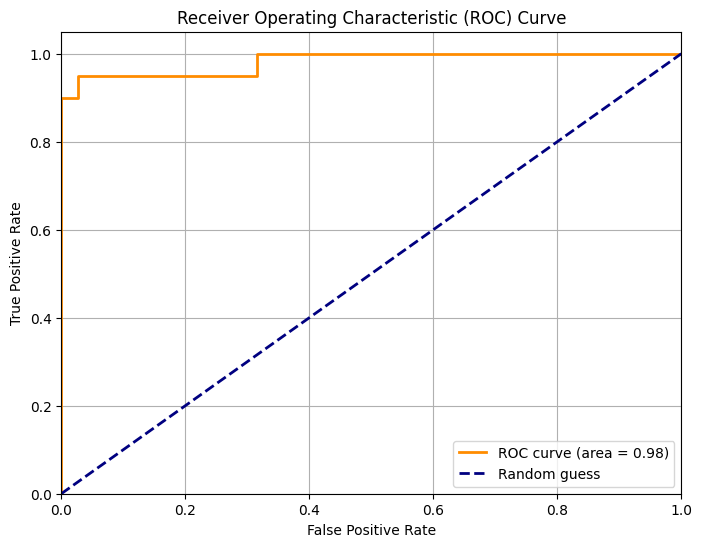

In [ ]:
from sklearn.metrics import roc_curve, auc
y_scores = y_pred_proba[:, 1]

# Compute ROC curve and ROC area
fpr, tpr, thresholds = roc_curve(y_test, y_scores)
roc_auc = auc(fpr, tpr)

# Plotting
plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, color='darkorange', lw=2,
         label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2,
         linestyle='--', label='Random guess')

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()


In [ ]:
from sklearn.metrics import classification_report

def display_model_performance_metrics(true_labels, predicted_labels,
                                      predicted_probabilities=None,
                                      classes=[0, 1]):

    # Calculate metrics
    accuracy = accuracy_score(true_labels, predicted_labels)
    precision = precision_score(true_labels, predicted_labels)
    recall = recall_score(true_labels,predicted_labels)
    f1 = f1_score(true_labels,predicted_labels)

    print("Model Performance metrics:")
    print("--------------------------------")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}\n")

    # Classification report
    class_report = classification_report(true_labels,
                                         predicted_labels,
                                         target_names=[f'Class {c}' for c in classes])
    
    print("Model Classification report:")
    print("--------------------------------")
    print(class_report)



In [95]:
display_model_performance_metrics(y_test,y_pred,y_pred_proba,[0 , 1])

Model Performance metrics:
--------------------------------
Accuracy: 0.9483
Precision: 0.9474
Recall: 0.9000
F1 Score: 0.9231

Model Classification report:
--------------------------------
              precision    recall  f1-score   support

     Class 0       0.95      0.97      0.96        38
     Class 1       0.95      0.90      0.92        20

    accuracy                           0.95        58
   macro avg       0.95      0.94      0.94        58
weighted avg       0.95      0.95      0.95        58



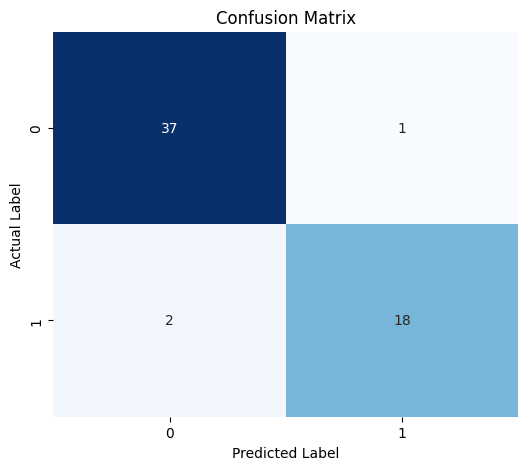

In [108]:
from sklearn.metrics import confusion_matrix

def plot_confusion_matrix(true_labels, predicted_labels, classes):
    # Compute confusion matrix
    cm = confusion_matrix(true_labels, predicted_labels)
    
    # Create a DataFrame for better visualization with class labels
    cm_df = pd.DataFrame(cm, index=classes, columns=classes)
    
    plt.figure(figsize=(6, 5))
    
    # Plot heatmap with annotations inside cells
    sns.heatmap(cm_df, annot=True, fmt='d', cmap='Blues', cbar=False)
    
    plt.title('Confusion Matrix')
    plt.ylabel('Actual Label')
    plt.xlabel('Predicted Label')
    
    plt.show()

# Example usage:
plot_confusion_matrix(y_test, y_pred, classes=[0,1])


100%|██████████| 229/229 [02:55<00:00,  1.31it/s]


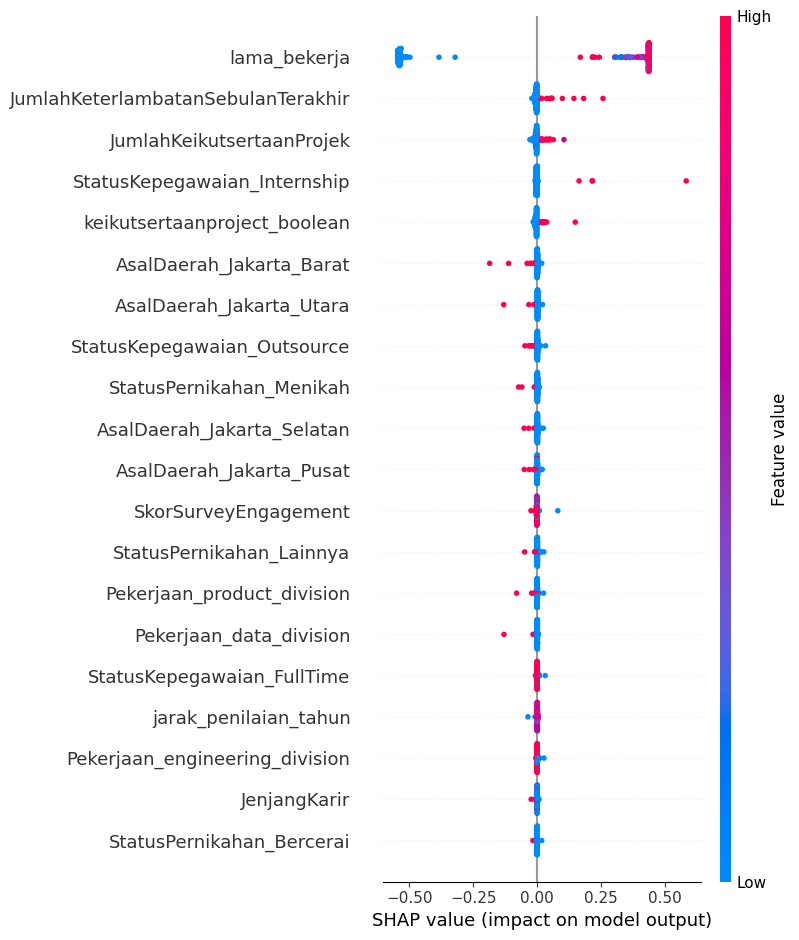

In [117]:
import shap
import numpy as np

# Select background dataset (a small subset of your training data)
background = X_tl.sample(n=100, random_state=42)  # or use X_tl.values[:100]

# Define prediction function returning probabilities for class 1
def f(x):
    return GaussianNB_model.predict_proba(x)[:,1]

# Create Kernel Explainer with background data and prediction function
explainer = shap.KernelExplainer(f, background)

# Calculate SHAP values on your dataset (X_tl)
shap_values = explainer.shap_values(X_tl)

# Plot summary plot
shap.summary_plot(shap_values, X_tl)


**Findings:**
- The `longer` employees had work, the higher chance they likely to `resign`. But also there is a `slightly chance` employee with `short` period likely to resign too.
- Employees who `often late` in work will likely to `resign`.
- Employees who `participated` in the `project` and the more they `take part` on it have a more chance to `resign`.
- Employees who `live` in Jakarta Barat and Utara are `more rarely` to resign instead of those who live in Jakarta Selatan and Pusat.
- `Intern` people is a `high` chance to resign, this might be due to the contract, meanhwile `outsource` less likely to resign.
- Employees who had `married` is `less` likely to resign.


# Conclusion

After we used GaussianNB model, we have score:
    - Accuracy: 0.9483
    - Precision: 0.9474
    - Recall: 0.9000
    - ROC AUC: 0.98

# Business Recommendation

Based on Exploratory Data Analysis, we know that Software Engineer (Front End) shows a high resignation rates linked to career change and remote work issues, Data Analysis resignation due to toxic culture, and based on SHAP value shows that Employees’ length of service strongly affects their likelihood to resign or stay. Frequent delays and project involvement also influence outcomes. So, we recommend for company to:

1. **Focus Retention Efforts on Key Employee Segments**
- Prioritize retention programs for employees with shorter tenure but high risk factors like frequent delays or low engagement.
- Monitor employees involved in multiple projects closely for burnout signs.

2. **Address Top Resignation Reasons by Role**
- For software engineers:
    - Improve remote work policies/flexibility where possible.
    - Provide clear career development paths to reduce turnover due to career changes.
    - Foster positive workplace culture; address toxic behaviors proactively.
- For data team:
    - Provide more appreciation and reward.
    - Foster a positive workplace culture to avoid internal conflict and behavior.
- For the rest role:
    - Developed a new working hours system.
    - Train the leader to have more leadership.
    - Provide clear career path for the role.

3. **Enhance Employee Engagement & Satisfaction**
- Conduct regular surveys focusing on job satisfaction, leadership quality, and workplace environment.

4. **Implement Predictive Monitoring**
- Use the predictive model regularly with updated data for early identification of at-risk employees based on key features like tenure, attendance patterns, project load, etc., enabling timely intervention.